# Skeletonize and dilate experiments
Here we want to evaluate the potential utility and feasibility of skeletonizing the rows to get a bette clustering. The interest of skeletonizing rows is double for row detection:
- Disambiguate when some rows are too close to each other (by thining each row until it is only 1-pixel wide)
- Reduce the number of pixels that we need to treat in our clustering algorithms to improve performances. The idea is that all the pixels of a row are not needed to detect it.

In [58]:
import numpy as np 
import matplotlib.pyplot as plt
import pandas as pd
import time

from skimage.morphology import skeletonize, binary_dilation, binary_erosion, binary_closing
from skimage import data
from skimage.util import invert

from sklearn.cluster import DBSCAN

## Direct skeleton on thin row

In [120]:
def plot_images(original, transformed, transformed_label="transformed", save_img_path=None):
    # display results
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 12),
                            sharex=True, sharey=True)

    ax = axes.ravel()

    ax[0].imshow(original, cmap=plt.cm.gray)
    ax[0].axis('off')
    ax[0].set_title('original', fontsize=20)

    ax[1].imshow(transformed, cmap=plt.cm.gray)
    ax[1].axis('off')
    ax[1].set_title(transformed_label, fontsize=20)

    fig.tight_layout()

    if save_img_path is not None:
        plt.savefig(save_img_path, format="svg")

    plt.show()

def cast_bool_to_float(array):
    """
    array (np.array<bool>)
    """
    ar = np.ones(array.shape)
    for i in range(array.shape[0]):
        for j in range(array.shape[1]):
            # for k in range(array.shape[2]):
            if not array[i, j]:
                ar[i, j] = 0
    return ar

def threshold(img, threshold=127):
    ar = np.ones(array.shape)
    for i in range(array.shape[0]):
        for j in range(array.shape[1]):
            # for k in range(array.shape[2]):
            if array[i, j] < threshold:
                ar[i, j] = 0
    return ar

def clustering(img, epsilon, min_point):
    # extraction of white pixels coordinates
    img_array = np.array(img)
    mat_coord = np.argwhere(img_array == 255)

    # clustering using DBSCAN
    mat_clustered = DBSCAN(eps=epsilon, min_samples=min_point).fit(mat_coord)

    # Panda dataframe
    dataframe_coord = pd.DataFrame(mat_coord)
    dataframe_coord = dataframe_coord.rename(columns={0: "X", 1: "Y"})
    label = pd.DataFrame(mat_clustered.labels_)
    label = label.rename(columns={0: "label"})

    # Dataframe gathering each plants pixel its label
    dataframe_coord = pd.concat([dataframe_coord, label], axis=1)
    return dataframe_coord

def plot_clusters(clusters):
    """
    clusters (dataframe) : label -> index of the cluster ; X and Y : coordinates
    """
    fig, ax = plt.subplots(1, 1, figsize=(12, 15))
    ax.scatter(clusters["Y"], clusters["X"], c=clusters["label"], s=1, cmap="Paired")
    for i in range(len(clusters["label"].unique().tolist())):
        xmed = np.median(clusters[clusters["label"] == i ])
        ymed = 
        ax.text()
    plt.show()

In [96]:
import imageio

path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Output/Session_1/Otsu_R/OTSU_R_022_088_0_2322_skeleton.png"
save_img_path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Analysis/skeleton2.svg"

image = imageio.imread(path)

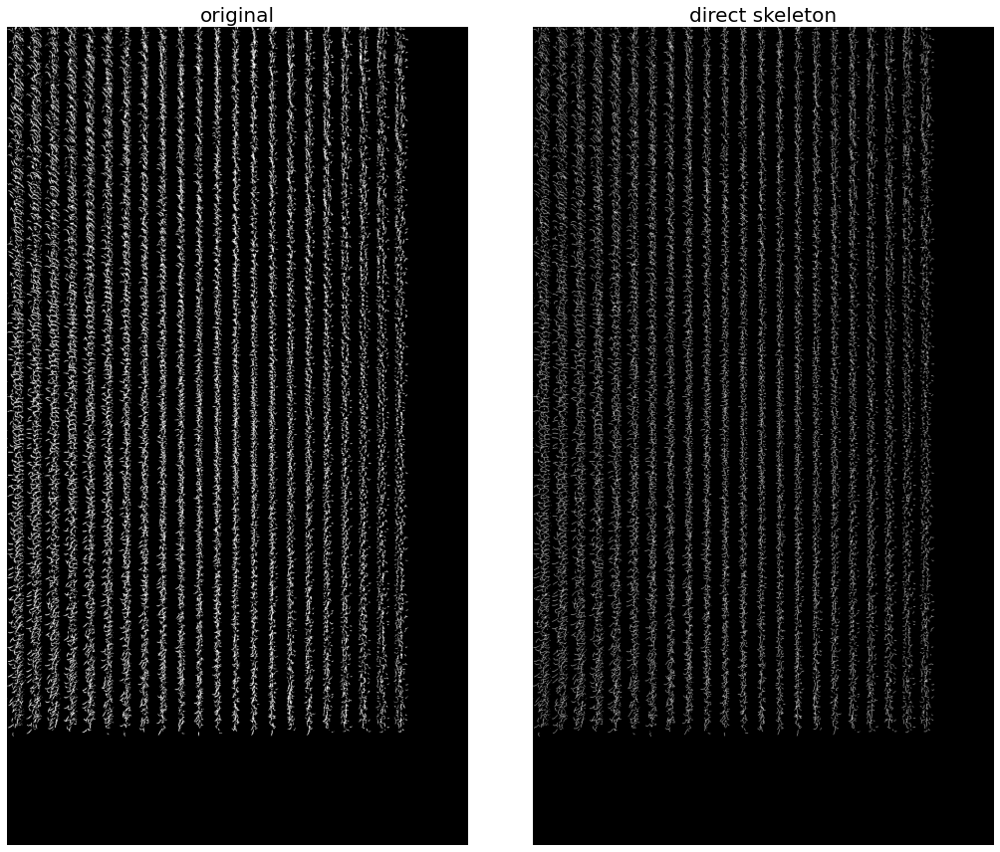

In [92]:
import imageio

path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Output/Session_1/Otsu_R/OTSU_R_022_088_0_2322.jpg"
save_img_path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Analysis/skeleton.svg"

image = imageio.imread(path)
img = threshold(np.asarray(image[:, :, 0]))
skeleton = skeletonize(img)

plot_images(img, skeleton, transformed_label="direct skeleton", save_img_path=save_img_path)


In [117]:
clusters = clustering(image, epsilon=2, min_point=2)


0    0
1    1
2    2
3    3
4    4
5    5
6    5
7    5
8    5
9    5
Name: label, dtype: int64
# Clusters : 148


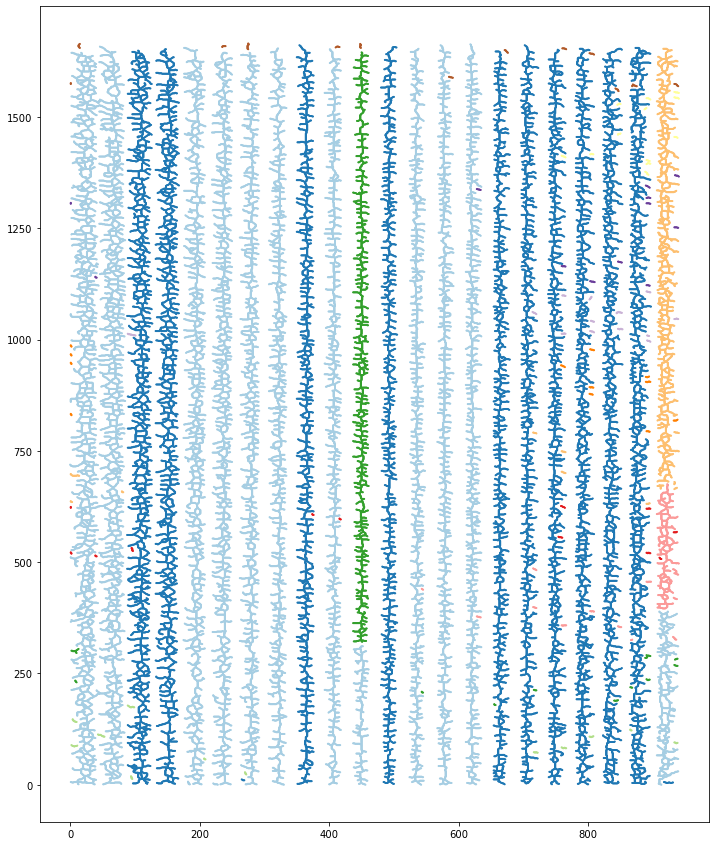

In [121]:
a = len(clusters["label"].unique().tolist())
print(clusters["label"][:10])
print(f"# Clusters : {a}")
plot_clusters(clusters)

## Dilate on thin row

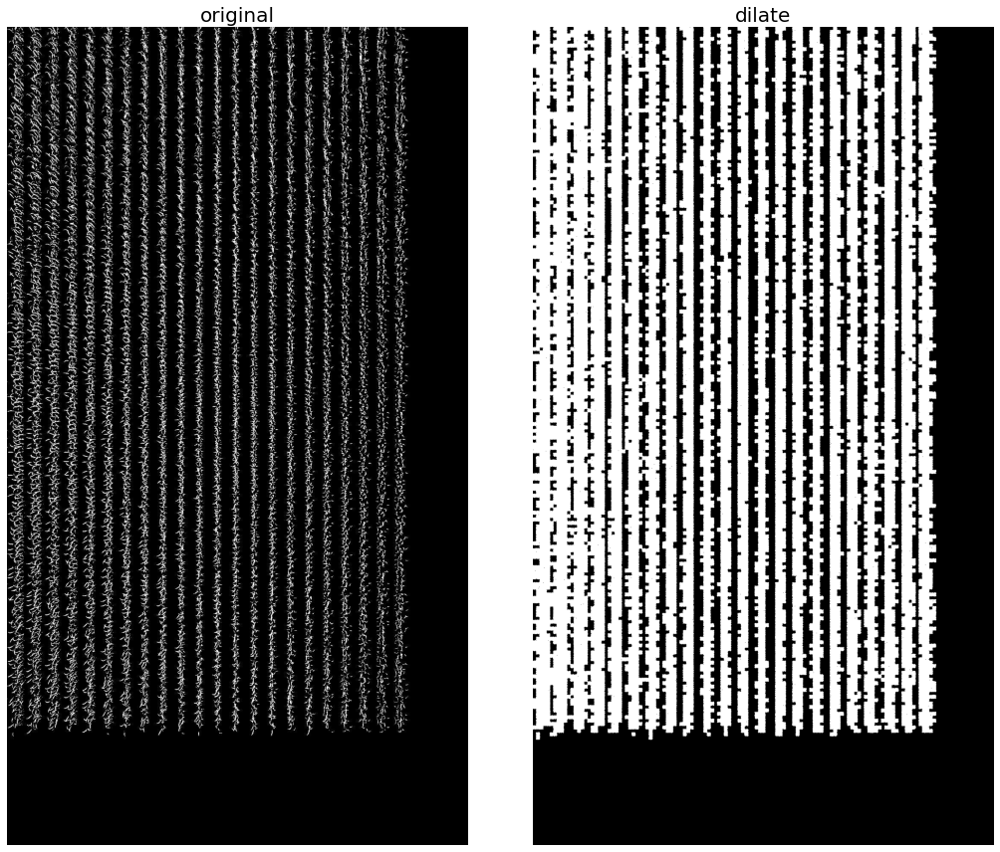

In [53]:
save_img_path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Analysis/dilate.svg"
dilate = cast_bool_to_float(binary_dilation(img))
plot_images(img, dilate, transformed_label="dilate", save_img_path=save_img_path)

## Dilate then skeletonize

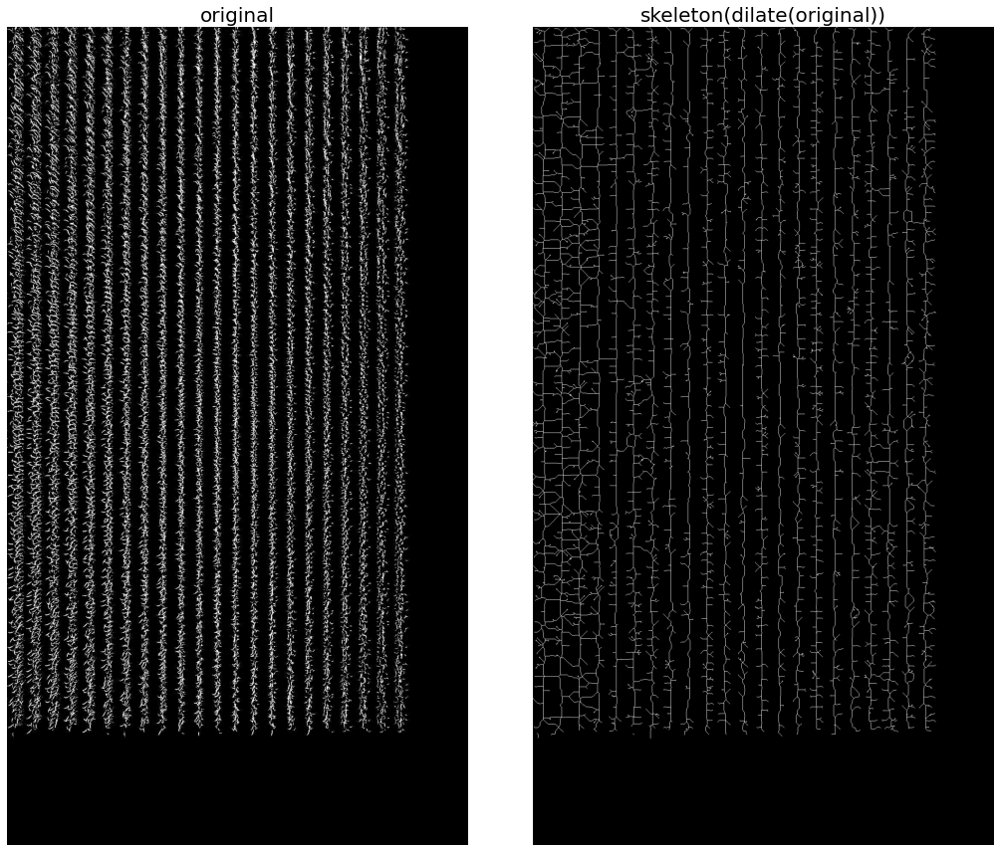

In [56]:
save_img_path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Analysis/dilate_then_skeleton.svg"
dps = skeletonize(cast_bool_to_float(binary_dilation(img)))
plot_images(img, dps, transformed_label="skeleton(dilate(original))", save_img_path=save_img_path)

## Erode and the skeletonize

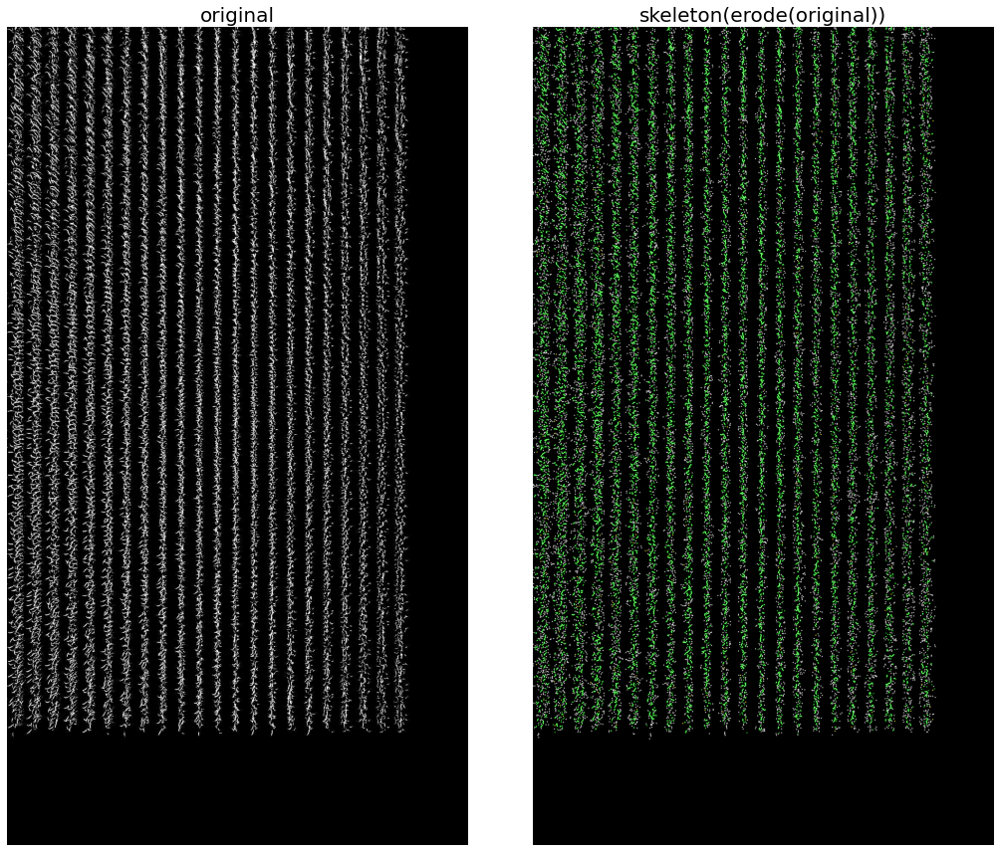

In [43]:
save_img_path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Analysis/erode_then_skeleton.svg"
dps = cast_bool_to_float(binary_dilation(skeletonize(cast_bool_to_float(binary_erosion(img)))))
plot_images(img, dps, transformed_label="skeleton(erode(original))")

## Binary closing

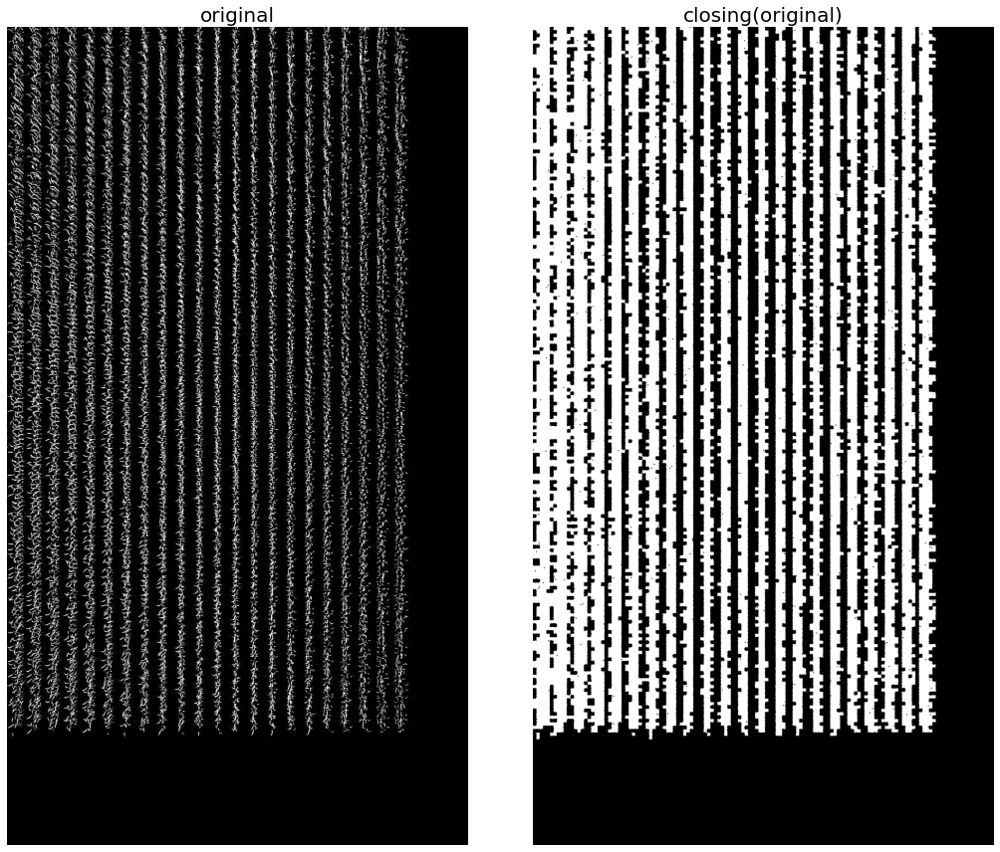

In [55]:
save_img_path = "D:/Documents/IODAA/Fil Rouge/Resultats/dIP_vs_dIR_linear_fixed_density_analysis/densite=5/0.22_0.88/Analysis/erode_then_skeleton.svg"
dps = cast_bool_to_float(binary_closing(img))
plot_images(img, dps, transformed_label="closing(original)")